# Differentially expressed gene analysis on super-boundaries

In [1]:
#load packages
library(Seurat)
library(ggplot2)
library(magrittr)
library(data.table)
library(Matrix)
library(dplyr)
library(tibble)
library(MAST)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:data.table’:

    between, first, last


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘matrixStats’


The following object is masked from ‘package:dplyr’:

    count



Attaching package: ‘MatrixGenerics’


The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
 

In [2]:
#load data
seu_PR <- readRDS(file = "../../data/seurat_object/Set3/seu_lateralect_PR_ID.obj")

In [3]:
seu_PR

An object of class Seurat 
28745 features across 1717 samples within 2 assays 
Active assay: SCT (11239 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, reumap

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
Warning message:
“Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session.”


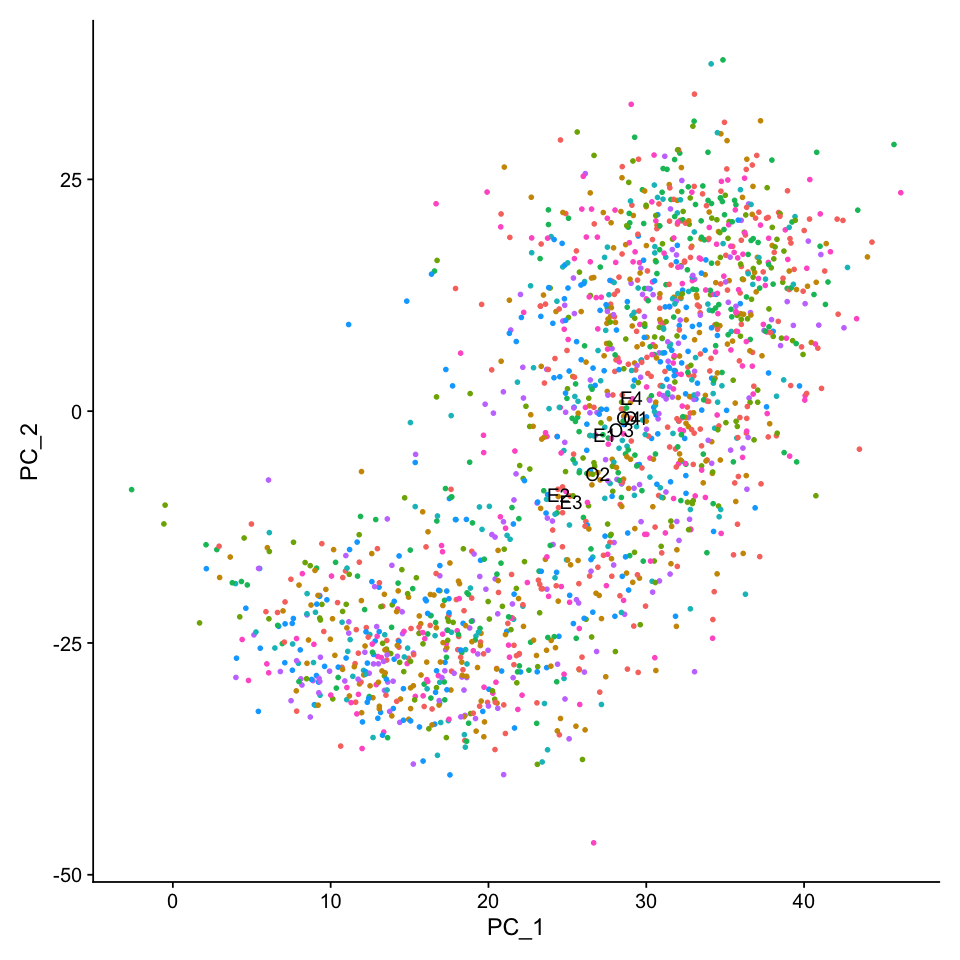

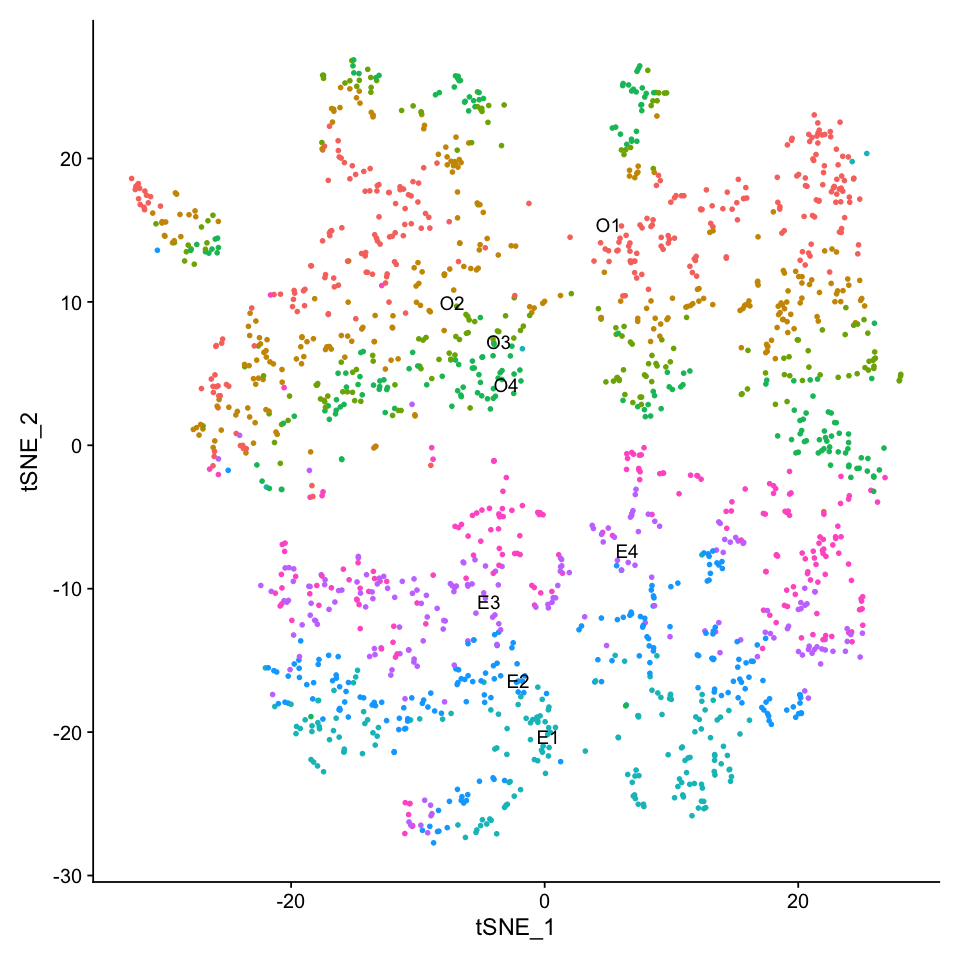

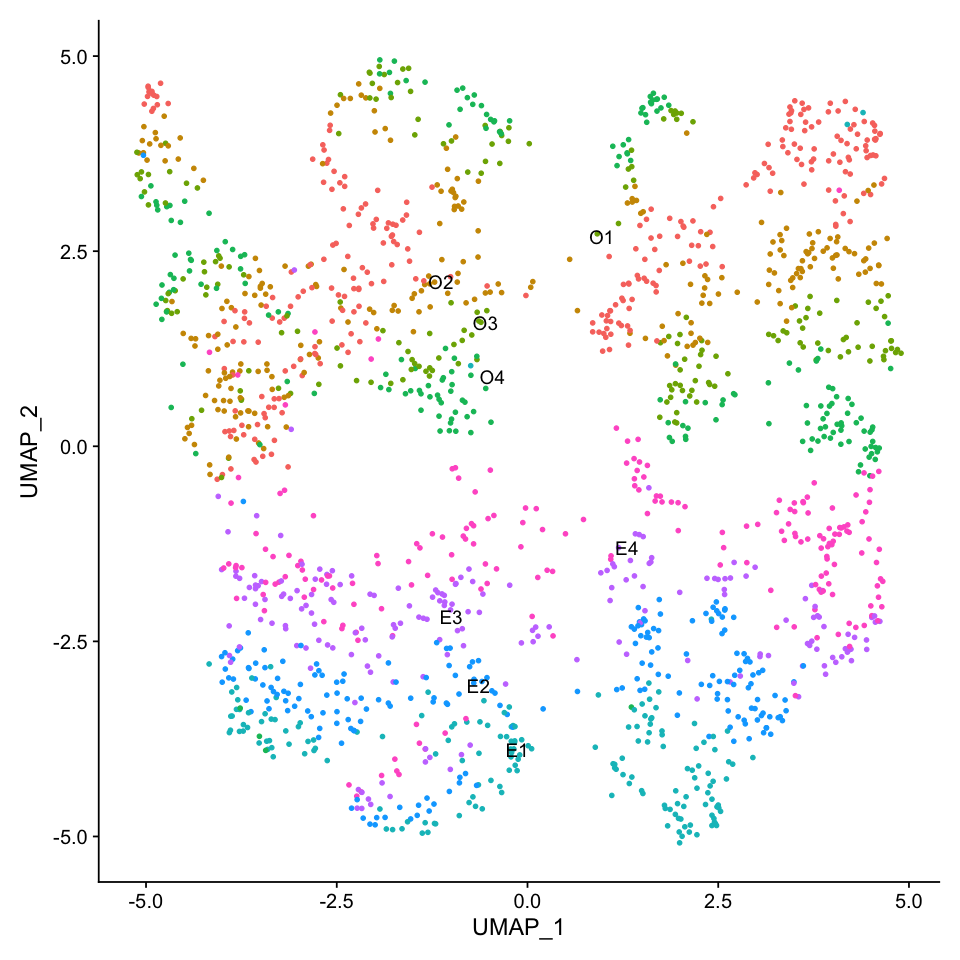

In [4]:
options(repr.plot.width=8, repr.plot.height=8)
seu_PR <- RunPCA(seu_PR, verbose = FALSE)
seu_PR <- RunTSNE(seu_PR, dims = 1:30, verbose = FALSE)
seu_PR <- RunUMAP(seu_PR, dims = 1:30, verbose = FALSE)
DimPlot(seu_PR, reduction =  "pca", label = TRUE) + NoLegend()
DimPlot(seu_PR, reduction =  "tsne", label = TRUE) + NoLegend()
DimPlot(seu_PR, reduction =  "umap", label = TRUE) + NoLegend()

## DEG analysis

In [5]:
Idents(seu_PR) <- "pairrule_ID"

In [6]:
levels <- c("O1","O2","O3","O4", "E1","E2","E3","E4")
levels(seu_PR) <- levels

In [7]:
seu_PR_VF3000 <- seu_PR[VariableFeatures(seu_PR), ]
seu_PR_VF3000

An object of class Seurat 
6000 features across 1717 samples within 2 assays 
Active assay: SCT (3000 features, 3000 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, umap, reumap, tsne

### O1 vs. O3


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
pxb,1.990864e-144,2.1899253,1.000,0.354,5.972592e-141,O1vsO3
hh,5.196754e-139,2.3203573,0.996,0.053,1.559026e-135,O1vsO3
eve,2.079641e-109,2.2680469,0.989,0.455,6.238923e-106,O1vsO3
mid,1.584758e-107,1.8990632,0.965,0.328,4.754274e-104,O1vsO3
run,2.032456e-105,-1.9959873,0.302,0.989,6.097368e-102,O1vsO3
en,1.538282e-100,1.9535365,0.944,0.095,4.614845e-97,O1vsO3
Tollo,4.127857e-99,1.1862407,1.000,0.963,1.238357e-95,O1vsO3
slp1,4.857894e-98,-1.9855340,0.330,0.979,1.457368e-94,O1vsO3
comm,2.632365e-90,-1.8895844,0.253,0.937,7.897094e-87,O1vsO3


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
pxb,1.990864e-144,2.1899253,1.000,0.354,5.972592e-141
hh,5.196754e-139,2.3203573,0.996,0.053,1.559026e-135
eve,2.079641e-109,2.2680469,0.989,0.455,6.238923e-106
mid,1.584758e-107,1.8990632,0.965,0.328,4.754274e-104
en,1.538282e-100,1.9535365,0.944,0.095,4.614845e-97
Tollo,4.127857e-99,1.1862407,1.000,0.963,1.238357e-95
gsb,7.897148e-68,2.3132185,0.814,0.085,2.369144e-64
rdx,1.493570e-59,0.8305945,1.000,0.989,4.480711e-56
pri,1.046933e-52,1.6484577,0.909,0.455,3.140798e-49


[1] 15  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
run,2.032456e-105,-1.9959873,0.302,0.989,6.097368e-102
slp1,4.857894e-98,-1.9855340,0.330,0.979,1.457368e-94
comm,2.632365e-90,-1.8895844,0.253,0.937,7.897094e-87
comm2,3.938682e-68,-1.2020814,0.084,0.804,1.181605e-64
slp2,2.923074e-31,-0.6392766,0.035,0.466,8.769221e-28
pio,7.833338e-26,-0.8958120,0.396,0.767,2.350001e-22
Toll-6,2.072091e-23,-0.9460775,0.863,0.958,6.216274e-20
CG15480,1.156598e-20,-0.9307150,0.670,0.910,3.469795e-17
rst,2.504341e-19,-0.5848501,0.109,0.455,7.513023e-16


[1] 15  5

[1] "DEGs O1vsO3, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs O1vsO3, avgFC <= -1.5, FWER <= 0.01"

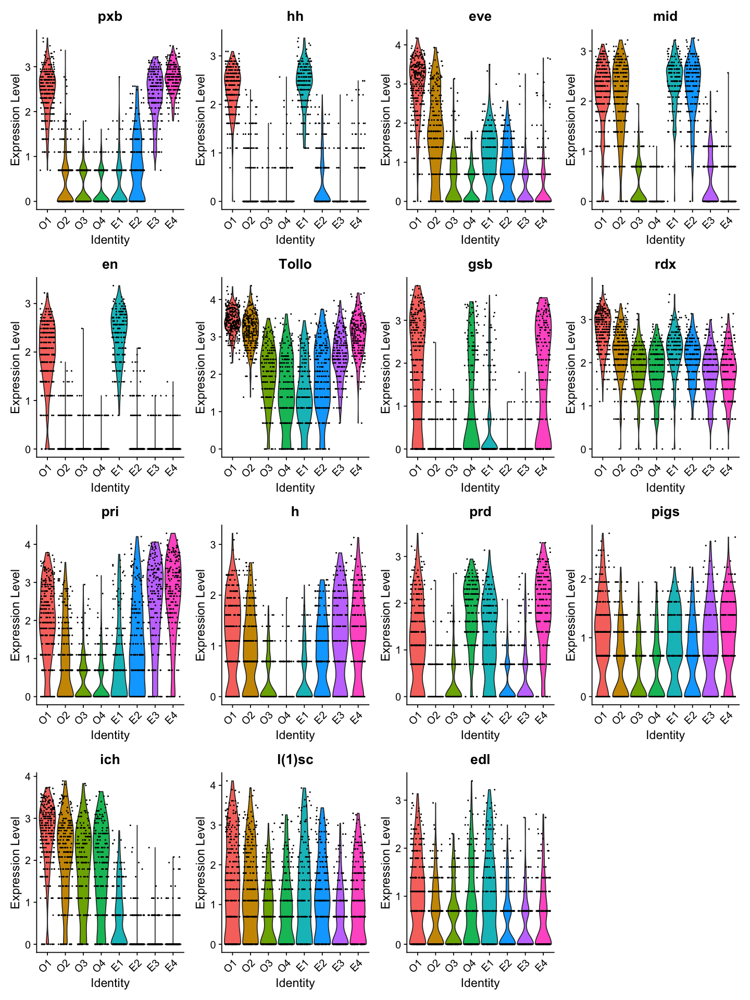

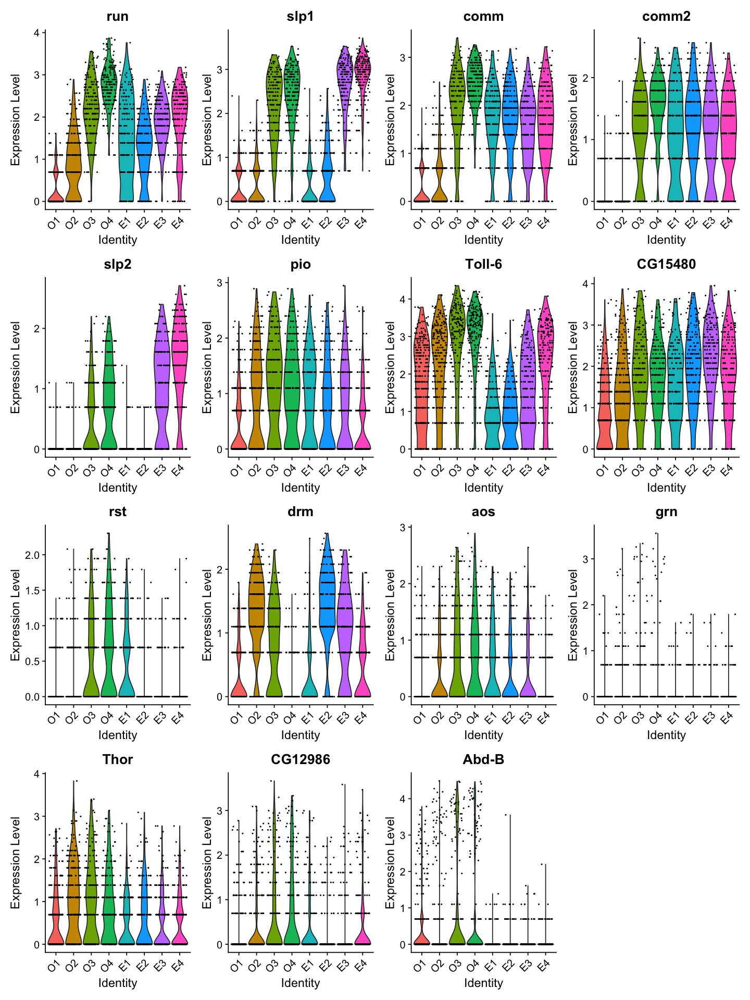

In [8]:
DE_O1vsO3 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O1",
  ident.2 = "O3",
  logfc.threshold = log(1.75),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O1vsO3_FWER0.01_FC1.75 <- filter(DE_O1vsO3, p_val_adj <= 0.01)

compaired_ID <- rep("O1vsO3", length=nrow(DE_O1vsO3_FWER0.01_FC1.75)) 
DE_O1vsO3_FWER0.01_FC1.75 <- cbind(DE_O1vsO3_FWER0.01_FC1.75, compaired_ID)
DE_O1vsO3_FWER0.01_FC1.75

DE_O1vsO3_FWER0.01_FC1.75_plus <- filter(DE_O1vsO3, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_O1vsO3_FWER0.01_FC1.75_plus
dim(DE_O1vsO3_FWER0.01_FC1.75_plus)
DE_O1vsO3_FWER0.01_FC1.75_minus <- filter(DE_O1vsO3, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_O1vsO3_FWER0.01_FC1.75_minus
dim(DE_O1vsO3_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O1vsO3_FWER0.01_FC1.75_plus)/4))
"DEGs O1vsO3, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O1vsO3_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O1vsO3_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O1vsO3_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O1vsO3_FWER0.01_FC1.75_minus)/4))
"DEGs O1vsO3, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O1vsO3_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O1vsO3_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O1vsO3_FWER0.01_FC1.75_minus)/4))

write.table(DE_O1vsO3_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_O1vsO3_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

### O2 vs. O4


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
wg,3.924299e-126,-2.1947538,0.069,0.995,1.177290e-122,O2vsO4
comm,7.907964e-124,-1.8901320,0.406,1.000,2.372389e-120,O2vsO4
odd,5.242900e-116,1.8238289,0.973,0.230,1.572870e-112,O2vsO4
run,2.785977e-115,-1.6904059,0.713,1.000,8.357932e-112,O2vsO4
slp1,8.734913e-113,-2.0952301,0.375,0.975,2.620474e-109,O2vsO4
mid,5.627977e-109,2.0770401,0.973,0.176,1.688393e-105,O2vsO4
18w,2.724611e-104,-1.7029283,0.575,0.985,8.173834e-101,O2vsO4
comm2,5.855860e-96,-1.4191207,0.157,0.966,1.756758e-92,O2vsO4
prd,4.250263e-90,-1.6642258,0.226,0.966,1.275079e-86,O2vsO4


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
odd,5.242900e-116,1.8238289,0.973,0.230,1.572870e-112
mid,5.627977e-109,2.0770401,0.973,0.176,1.688393e-105
Tollo,1.533007e-84,1.2744213,1.000,0.858,4.599020e-81
sob,2.808772e-75,1.2704703,0.889,0.123,8.426315e-72
drm,3.726765e-71,1.2117757,0.916,0.201,1.118030e-67
eve,1.748387e-46,1.7257007,0.835,0.377,5.245161e-43
h,2.811059e-34,0.9744181,0.705,0.181,8.433177e-31
toc,1.717434e-24,1.2422441,0.724,0.324,5.152303e-21
upd1,4.495843e-21,0.8522119,0.410,0.059,1.348753e-17


[1] 14  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
wg,3.924299e-126,-2.1947538,0.069,0.995,1.177290e-122
comm,7.907964e-124,-1.8901320,0.406,1.000,2.372389e-120
run,2.785977e-115,-1.6904059,0.713,1.000,8.357932e-112
slp1,8.734913e-113,-2.0952301,0.375,0.975,2.620474e-109
18w,2.724611e-104,-1.7029283,0.575,0.985,8.173834e-101
comm2,5.855860e-96,-1.4191207,0.157,0.966,1.756758e-92
prd,4.250263e-90,-1.6642258,0.226,0.966,1.275079e-86
slp2,4.205041e-48,-0.9101337,0.046,0.642,1.261512e-44
gsb,9.553449e-32,-1.6531197,0.123,0.554,2.866035e-28


[1] 11  5

[1] "DEGs O2vsO4, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs O2vsO4, avgFC <= -1.5, FWER <= 0.01"

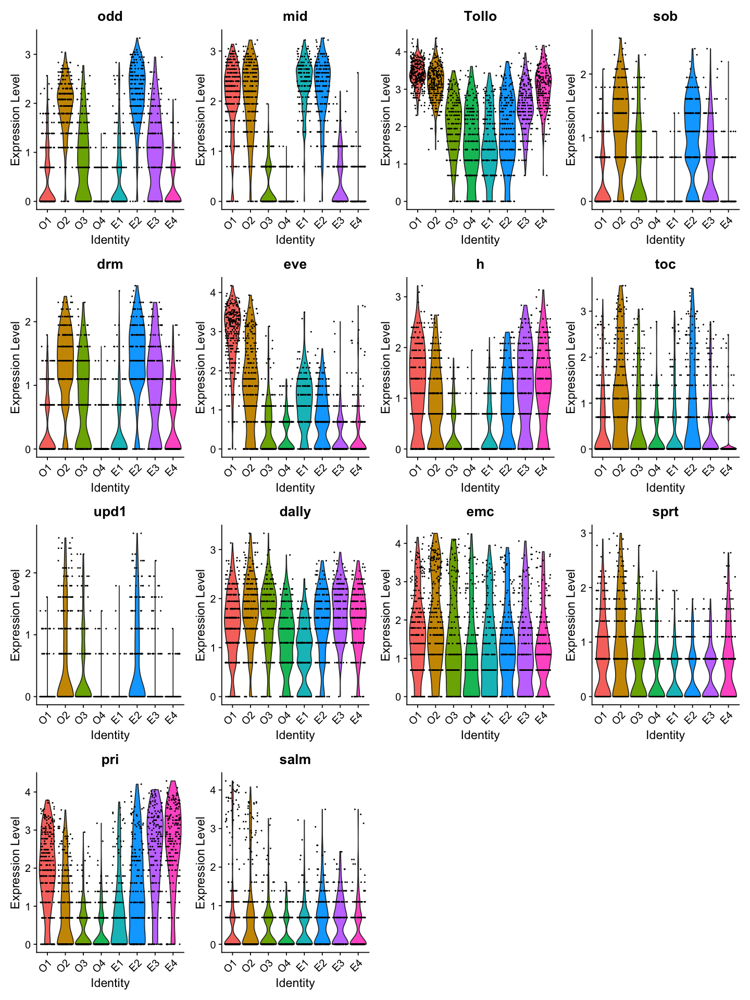

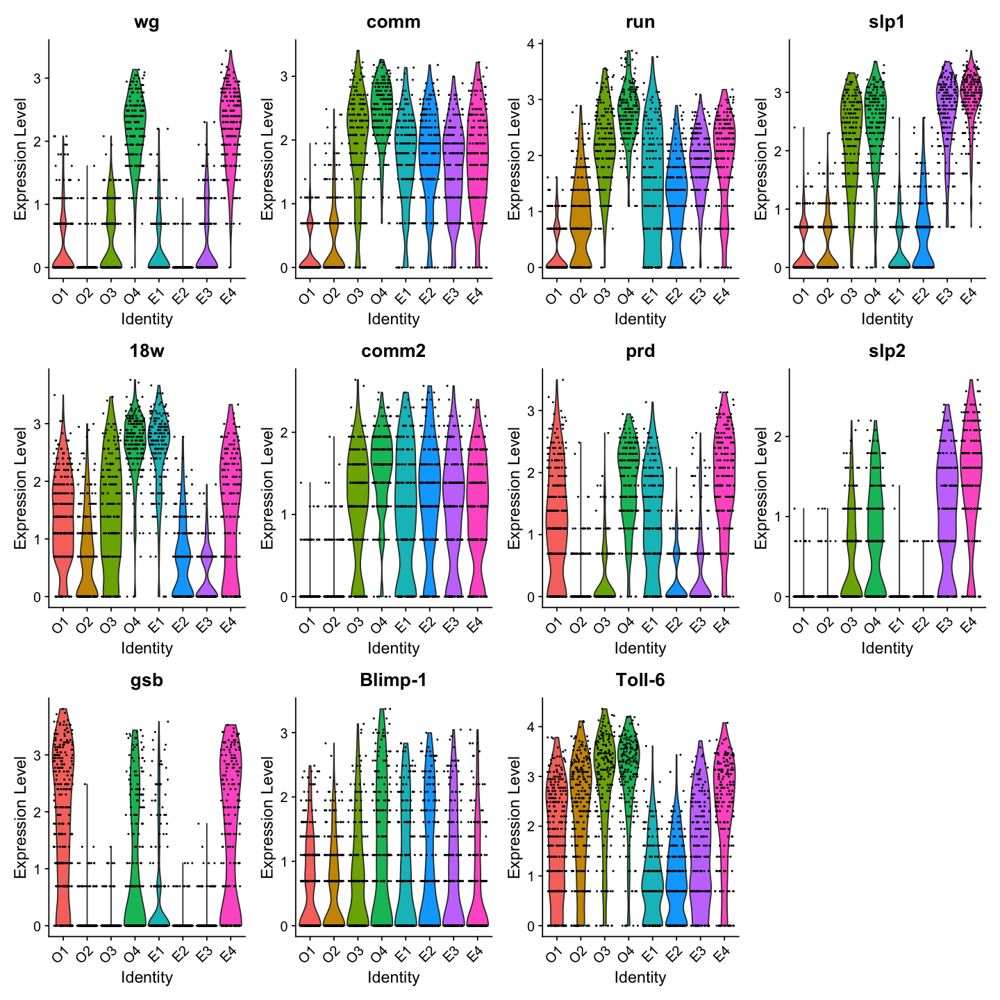

In [9]:
DE_O2vsO4 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O2",
  ident.2 = "O4",
  logfc.threshold = log(1.75),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O2vsO4_FWER0.01_FC1.75 <- filter(DE_O2vsO4, p_val_adj <= 0.01)

compaired_ID <- rep("O2vsO4", length=nrow(DE_O2vsO4_FWER0.01_FC1.75)) 
DE_O2vsO4_FWER0.01_FC1.75 <- cbind(DE_O2vsO4_FWER0.01_FC1.75, compaired_ID)
DE_O2vsO4_FWER0.01_FC1.75

DE_O2vsO4_FWER0.01_FC1.75_plus <- filter(DE_O2vsO4, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_O2vsO4_FWER0.01_FC1.75_plus
dim(DE_O2vsO4_FWER0.01_FC1.75_plus)
DE_O2vsO4_FWER0.01_FC1.75_minus <- filter(DE_O2vsO4, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_O2vsO4_FWER0.01_FC1.75_minus
dim(DE_O2vsO4_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O2vsO4_FWER0.01_FC1.75_plus)/4))
"DEGs O2vsO4, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O2vsO4_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O2vsO4_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O2vsO4_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O2vsO4_FWER0.01_FC1.75_minus)/4))
"DEGs O2vsO4, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O2vsO4_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O2vsO4_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O2vsO4_FWER0.01_FC1.75_minus)/4))

write.table(DE_O2vsO4_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_O2vsO4_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)





### O3 vs. E1


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
trn,6.218384e-153,-2.6263970,0.831,1.000,1.865515e-149,O3vsE1
ftz,1.809534e-129,-2.6116275,0.302,1.000,5.428601e-126,O3vsE1
mid,2.658517e-112,-2.0746863,0.328,0.994,7.975551e-109,O3vsE1
hh,4.974470e-111,-2.4218866,0.053,1.000,1.492341e-107,O3vsE1
en,1.599985e-104,-2.2931649,0.095,1.000,4.799956e-101,O3vsE1
slp1,9.383694e-73,1.9291527,0.979,0.328,2.815108e-69,O3vsE1
Toll-6,4.825096e-54,1.8957931,0.958,0.712,1.447529e-50,O3vsE1
ImpL2,2.317436e-43,1.2468863,1.000,0.966,6.952309e-40,O3vsE1
18w,2.582866e-30,-0.8621948,0.831,0.977,7.748599e-27,O3vsE1


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,9.383694e-73,1.9291527,0.979,0.328,2.815108e-69
Toll-6,4.825096e-54,1.8957931,0.958,0.712,1.447529e-50
ImpL2,2.317436e-43,1.2468863,1.000,0.966,6.952309e-40
ich,8.169367e-28,1.2496012,0.884,0.525,2.450810e-24
dally,5.061525e-24,0.7433968,0.942,0.751,1.518457e-20
slp2,5.313417e-21,0.6115496,0.466,0.051,1.594025e-17
path,2.921529e-15,0.5796684,0.968,0.881,8.764588e-12
sob,1.073658e-13,0.6079414,0.450,0.119,3.220973e-10
Abd-B,1.309190e-13,2.1509810,0.333,0.090,3.927571e-10


[1] 15  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
trn,6.218384e-153,-2.6263970,0.831,1.000,1.865515e-149
ftz,1.809534e-129,-2.6116275,0.302,1.000,5.428601e-126
mid,2.658517e-112,-2.0746863,0.328,0.994,7.975551e-109
hh,4.974470e-111,-2.4218866,0.053,1.000,1.492341e-107
en,1.599985e-104,-2.2931649,0.095,1.000,4.799956e-101
18w,2.582866e-30,-0.8621948,0.831,0.977,7.748599e-27
prd,4.105626e-29,-1.0805371,0.280,0.791,1.231688e-25
blot,2.563074e-19,-0.6169328,0.931,0.994,7.689222e-16
CG4702,1.944841e-18,-1.2002856,0.164,0.554,5.834522e-15


[1] 16  5

[1] "DEGs O3vsE1, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs O3vsE1, avgFC <= -1.5, FWER <= 0.01"

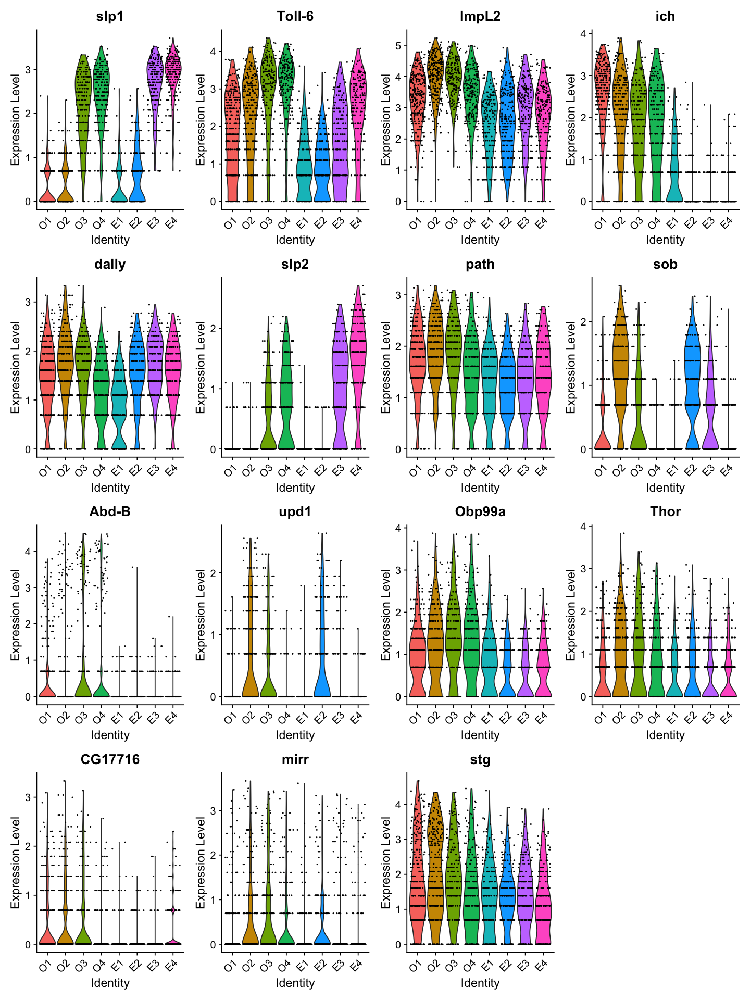

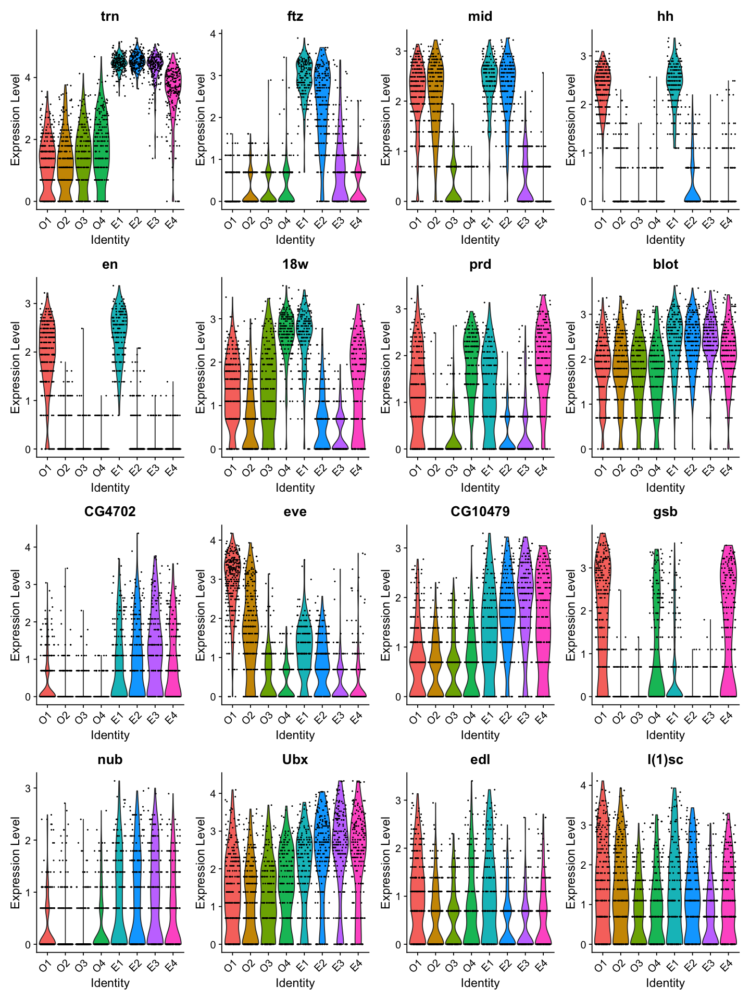

In [10]:
DE_O3vsE1 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O3",
  ident.2 = "E1",
  logfc.threshold = log(1.75),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O3vsE1_FWER0.01_FC1.75 <- filter(DE_O3vsE1, p_val_adj <= 0.01)

compaired_ID <- rep("O3vsE1", length=nrow(DE_O3vsE1_FWER0.01_FC1.75)) 
DE_O3vsE1_FWER0.01_FC1.75 <- cbind(DE_O3vsE1_FWER0.01_FC1.75, compaired_ID)
DE_O3vsE1_FWER0.01_FC1.75

DE_O3vsE1_FWER0.01_FC1.75_plus <- filter(DE_O3vsE1, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_O3vsE1_FWER0.01_FC1.75_plus
dim(DE_O3vsE1_FWER0.01_FC1.75_plus)
DE_O3vsE1_FWER0.01_FC1.75_minus <- filter(DE_O3vsE1, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_O3vsE1_FWER0.01_FC1.75_minus
dim(DE_O3vsE1_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O3vsE1_FWER0.01_FC1.75_plus)/4))
"DEGs O3vsE1, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O3vsE1_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O3vsE1_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O3vsE1_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O3vsE1_FWER0.01_FC1.75_minus)/4))
"DEGs O3vsE1, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O3vsE1_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O3vsE1_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O3vsE1_FWER0.01_FC1.75_minus)/4))

write.table(DE_O3vsE1_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_O3vsE1_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)


### O4 vs. E2


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
trn,1.749036e-144,-2.3143987,0.877,1.000,5.247107e-141,O4vsE2
wg,5.404805e-117,2.2495551,0.995,0.054,1.621442e-113,O4vsE2
mid,7.872077e-112,-2.1966137,0.176,0.990,2.361623e-108,O4vsE2
odd,9.248011e-110,-2.1143079,0.230,0.980,2.774403e-106,O4vsE2
18w,8.893531e-103,1.8191854,0.985,0.567,2.668059e-99,O4vsE2
slp1,8.259052e-83,1.7507723,0.975,0.542,2.477716e-79,O4vsE2
run,3.559485e-82,1.3658455,1.000,0.813,1.067845e-78,O4vsE2
Toll-6,9.251763e-80,1.9803946,0.961,0.714,2.775529e-76,O4vsE2
prd,3.961869e-77,1.6229105,0.966,0.296,1.188561e-73,O4vsE2


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
wg,5.404805e-117,2.2495551,0.995,0.054,1.621442e-113
18w,8.893531e-103,1.8191854,0.985,0.567,2.668059e-99
slp1,8.259052e-83,1.7507723,0.975,0.542,2.477716e-79
run,3.559485e-82,1.3658455,1.000,0.813,1.067845e-78
Toll-6,9.251763e-80,1.9803946,0.961,0.714,2.775529e-76
prd,3.961869e-77,1.6229105,0.966,0.296,1.188561e-73
ich,9.061526e-55,1.8491417,0.853,0.202,2.718458e-51
slp2,1.519831e-40,0.9085821,0.642,0.059,4.559492e-37
halo,1.737120e-39,1.3825932,0.926,0.576,5.211360e-36


[1] 17  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
trn,1.749036e-144,-2.3143987,0.877,1.000,5.247107e-141
mid,7.872077e-112,-2.1966137,0.176,0.990,2.361623e-108
odd,9.248011e-110,-2.1143079,0.230,0.980,2.774403e-106
ftz,3.445241e-72,-2.0023960,0.338,0.936,1.033572e-68
drm,4.783642e-69,-1.3137566,0.201,0.921,1.435093e-65
sob,5.697182e-52,-1.0491411,0.123,0.803,1.709154e-48
5-HT2A,9.028608e-38,-1.0503888,0.554,0.916,2.708582e-34
CG10479,2.137857e-33,-0.9878838,0.593,0.941,6.413572e-30
CG4702,2.469983e-31,-1.4690143,0.152,0.650,7.409950e-28


[1] 25  5

[1] "DEGs O4vsE2, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs O4vsE2, avgFC <= -1.5, FWER <= 0.01"

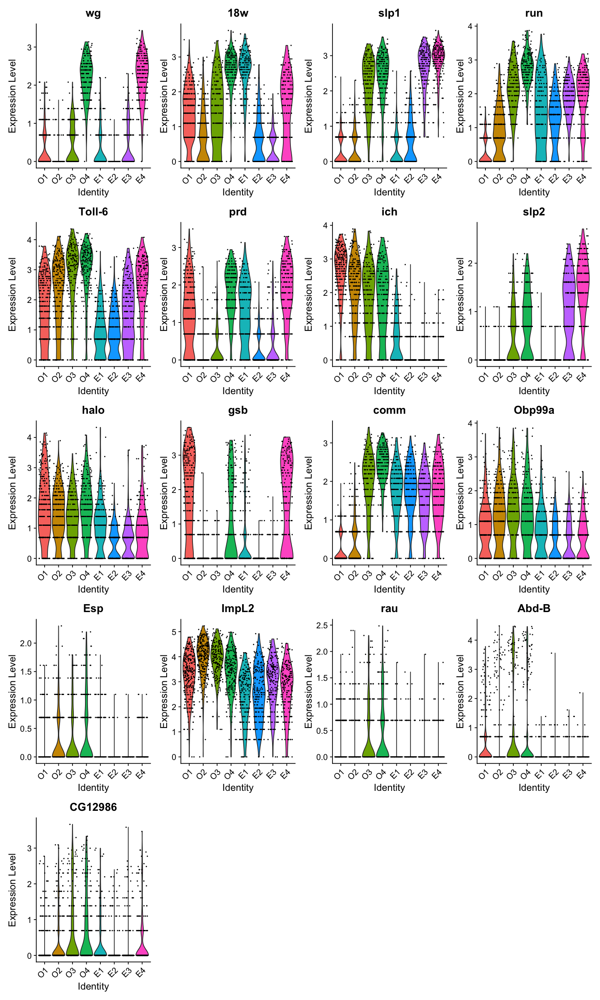

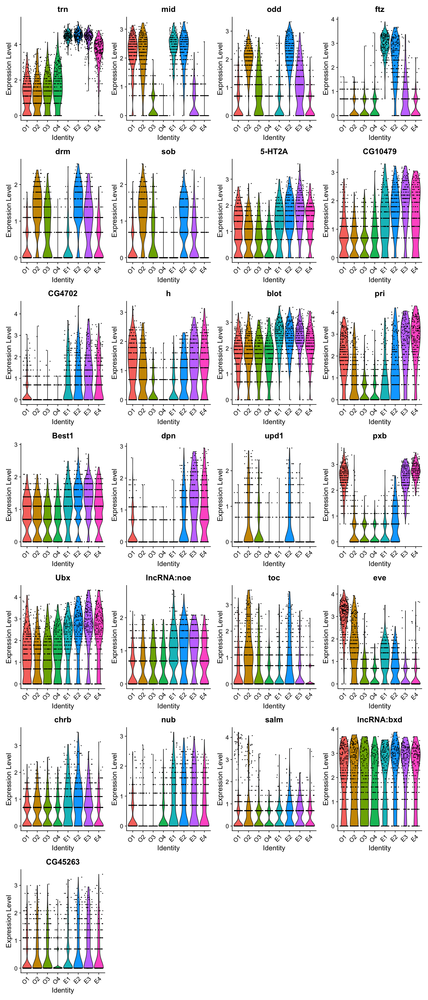

In [11]:
DE_O4vsE2 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O4",
  ident.2 = "E2",
  logfc.threshold = log(1.75),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O4vsE2_FWER0.01_FC1.75 <- filter(DE_O4vsE2, p_val_adj <= 0.01)

compaired_ID <- rep("O4vsE2", length=nrow(DE_O4vsE2_FWER0.01_FC1.75)) 
DE_O4vsE2_FWER0.01_FC1.75 <- cbind(DE_O4vsE2_FWER0.01_FC1.75, compaired_ID)
DE_O4vsE2_FWER0.01_FC1.75

DE_O4vsE2_FWER0.01_FC1.75_plus <- filter(DE_O4vsE2, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_O4vsE2_FWER0.01_FC1.75_plus
dim(DE_O4vsE2_FWER0.01_FC1.75_plus)
DE_O4vsE2_FWER0.01_FC1.75_minus <- filter(DE_O4vsE2, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_O4vsE2_FWER0.01_FC1.75_minus
dim(DE_O4vsE2_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O4vsE2_FWER0.01_FC1.75_plus)/4))
"DEGs O4vsE2, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O4vsE2_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O4vsE2_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O4vsE2_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O4vsE2_FWER0.01_FC1.75_minus)/4))
"DEGs O4vsE2, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O4vsE2_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O4vsE2_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O4vsE2_FWER0.01_FC1.75_minus)/4))

write.table(DE_O4vsE2_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_O4vsE2_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)


### E1 vs. E3


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
en,4.217292e-109,2.3376252,1.000,0.098,1.265188e-105,E1vsE3
hh,2.251587e-106,2.3540319,1.000,0.062,6.754762e-103,E1vsE3
slp1,3.702461e-102,-2.3258984,0.328,1.000,1.110738e-98,E1vsE3
mid,5.117410e-101,1.8718736,0.994,0.397,1.535223e-97,E1vsE3
18w,5.523664e-101,2.2113348,0.977,0.418,1.657099e-97,E1vsE3
pxb,1.508635e-99,-2.0097785,0.328,1.000,4.525904e-96,E1vsE3
ftz,1.571927e-90,1.8008848,1.000,0.567,4.715781e-87,E1vsE3
slp2,7.179842e-51,-1.1812572,0.051,0.763,2.153953e-47,E1vsE3
dpn,4.057099e-49,-1.4311615,0.085,0.789,1.217130e-45,E1vsE3


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
en,4.217292e-109,2.3376252,1.000,0.098,1.265188e-105
hh,2.251587e-106,2.3540319,1.000,0.062,6.754762e-103
mid,5.117410e-101,1.8718736,0.994,0.397,1.535223e-97
18w,5.523664e-101,2.2113348,0.977,0.418,1.657099e-97
ftz,1.571927e-90,1.8008848,1.000,0.567,4.715781e-87
eve,1.359761e-29,0.8852183,0.853,0.351,4.079284e-26
Sema5c,1.157091e-26,0.8491047,0.836,0.423,3.471274e-23
prd,4.496362e-20,0.8206398,0.791,0.361,1.348909e-16
sca,3.094621e-15,0.7216442,0.977,0.881,9.283864e-12


[1] 16  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,3.702461e-102,-2.3258984,0.328,1.000,1.110738e-98
pxb,1.508635e-99,-2.0097785,0.328,1.000,4.525904e-96
slp2,7.179842e-51,-1.1812572,0.051,0.763,2.153953e-47
dpn,4.057099e-49,-1.4311615,0.085,0.789,1.217130e-45
dally,1.570978e-35,-0.8117342,0.751,0.995,4.712935e-32
Tollo,8.118633e-31,-0.8184714,0.898,1.000,2.435590e-27
pri,1.384696e-29,-1.3103917,0.576,0.912,4.154087e-26
h,3.484368e-22,-0.9434435,0.373,0.763,1.045310e-18
drm,1.049800e-21,-0.7295599,0.277,0.742,3.149401e-18


[1] 15  5

[1] "DEGs E1vsE3, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs E1vsE3, avgFC <= -1.5, FWER <= 0.01"

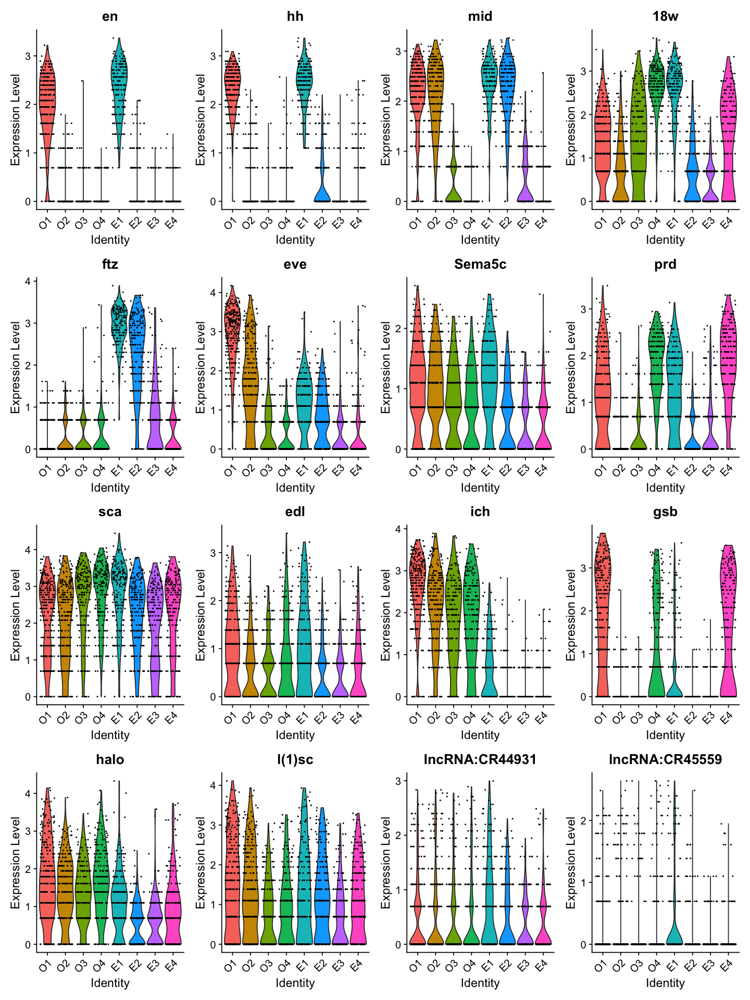

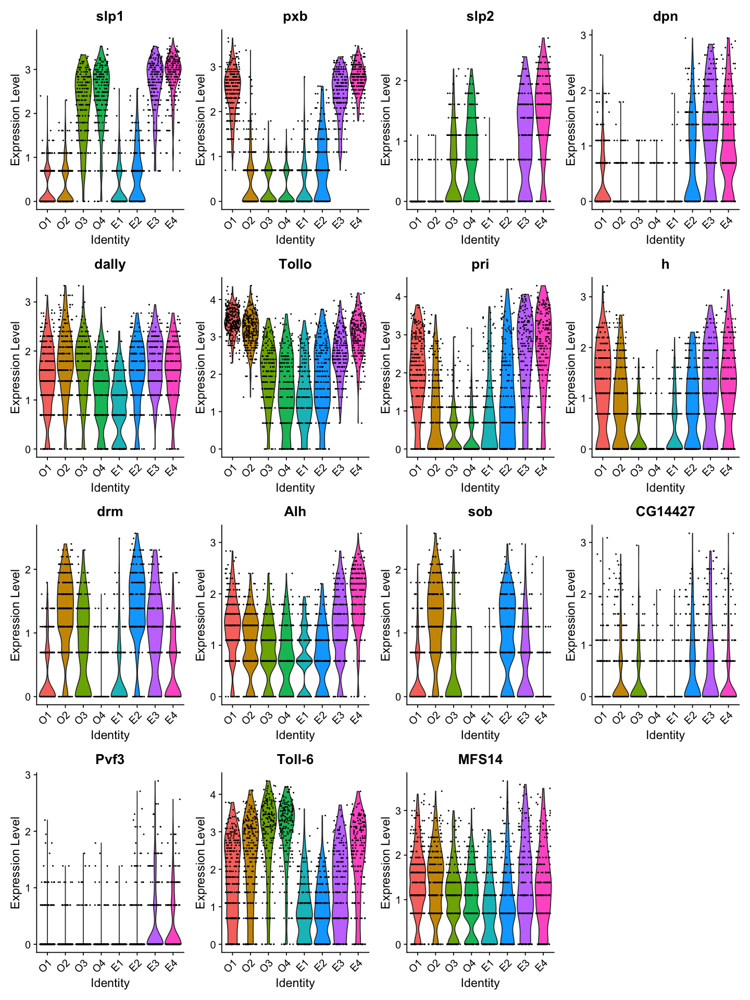

In [12]:
DE_E1vsE3 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E1",
  ident.2 = "E3",
  logfc.threshold = log(1.75),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E1vsE3_FWER0.01_FC1.75 <- filter(DE_E1vsE3, p_val_adj <= 0.01)

compaired_ID <- rep("E1vsE3", length=nrow(DE_E1vsE3_FWER0.01_FC1.75)) 
DE_E1vsE3_FWER0.01_FC1.75 <- cbind(DE_E1vsE3_FWER0.01_FC1.75, compaired_ID)
DE_E1vsE3_FWER0.01_FC1.75

DE_E1vsE3_FWER0.01_FC1.75_plus <- filter(DE_E1vsE3, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_E1vsE3_FWER0.01_FC1.75_plus
dim(DE_E1vsE3_FWER0.01_FC1.75_plus)
DE_E1vsE3_FWER0.01_FC1.75_minus <- filter(DE_E1vsE3, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_E1vsE3_FWER0.01_FC1.75_minus
dim(DE_E1vsE3_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E1vsE3_FWER0.01_FC1.75_plus)/4))
"DEGs E1vsE3, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E1vsE3_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E1vsE3_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E1vsE3_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E1vsE3_FWER0.01_FC1.75_minus)/4))
"DEGs E1vsE3, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E1vsE3_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E1vsE3_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E1vsE3_FWER0.01_FC1.75_minus)/4))

write.table(DE_E1vsE3_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_E1vsE3_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)


### E2 vs. E4


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
slp1,7.178131e-126,-2.1263088,0.542,1.000,2.153439e-122,E2vsE4
pxb,9.114391e-125,-1.7262565,0.635,1.000,2.734317e-121,E2vsE4
wg,3.027840e-114,-2.3027743,0.054,0.995,9.083521e-111,E2vsE4
mid,3.228637e-105,2.1058216,0.990,0.201,9.685911e-102,E2vsE4
odd,3.095102e-96,1.9153937,0.980,0.304,9.285307e-93,E2vsE4
slp2,7.754470e-79,-1.5771766,0.059,0.882,2.326341e-75,E2vsE4
ftz,3.485183e-74,2.0927048,0.936,0.353,1.045555e-70,E2vsE4
prd,1.728543e-69,-1.7459280,0.296,0.941,5.185629e-66,E2vsE4
Alh,3.183324e-56,-1.0818120,0.739,0.975,9.549973e-53,E2vsE4


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
mid,3.228637e-105,2.1058216,0.990,0.201,9.685911e-102
odd,3.095102e-96,1.9153937,0.980,0.304,9.285307e-93
ftz,3.485183e-74,2.0927048,0.936,0.353,1.045555e-70
trn,1.435394e-49,0.8226007,1.000,0.975,4.306182e-46
drm,3.149434e-46,0.9772844,0.921,0.456,9.448303e-43
sob,1.729320e-41,0.9318351,0.803,0.196,5.187961e-38
upd1,7.004632e-21,0.8295744,0.424,0.059,2.101390e-17
toc,3.305485e-16,1.1347788,0.571,0.250,9.916454e-13
cv-c,3.612793e-15,0.6508083,0.911,0.716,1.083838e-11


[1] 10  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,7.178131e-126,-2.1263088,0.542,1.000,2.153439e-122
pxb,9.114391e-125,-1.7262565,0.635,1.000,2.734317e-121
wg,3.027840e-114,-2.3027743,0.054,0.995,9.083521e-111
slp2,7.754470e-79,-1.5771766,0.059,0.882,2.326341e-75
prd,1.728543e-69,-1.7459280,0.296,0.941,5.185629e-66
Alh,3.183324e-56,-1.0818120,0.739,0.975,9.549973e-53
gsb,3.852364e-50,-2.1627166,0.074,0.691,1.155709e-46
Toll-6,2.429086e-42,-1.4463803,0.714,0.902,7.287257e-39
Tollo,7.314628e-42,-0.8938096,0.926,1.000,2.194388e-38


[1] 16  5

[1] "DEGs E2vsE4, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs E2vsE4, avgFC <= -1.5, FWER <= 0.01"

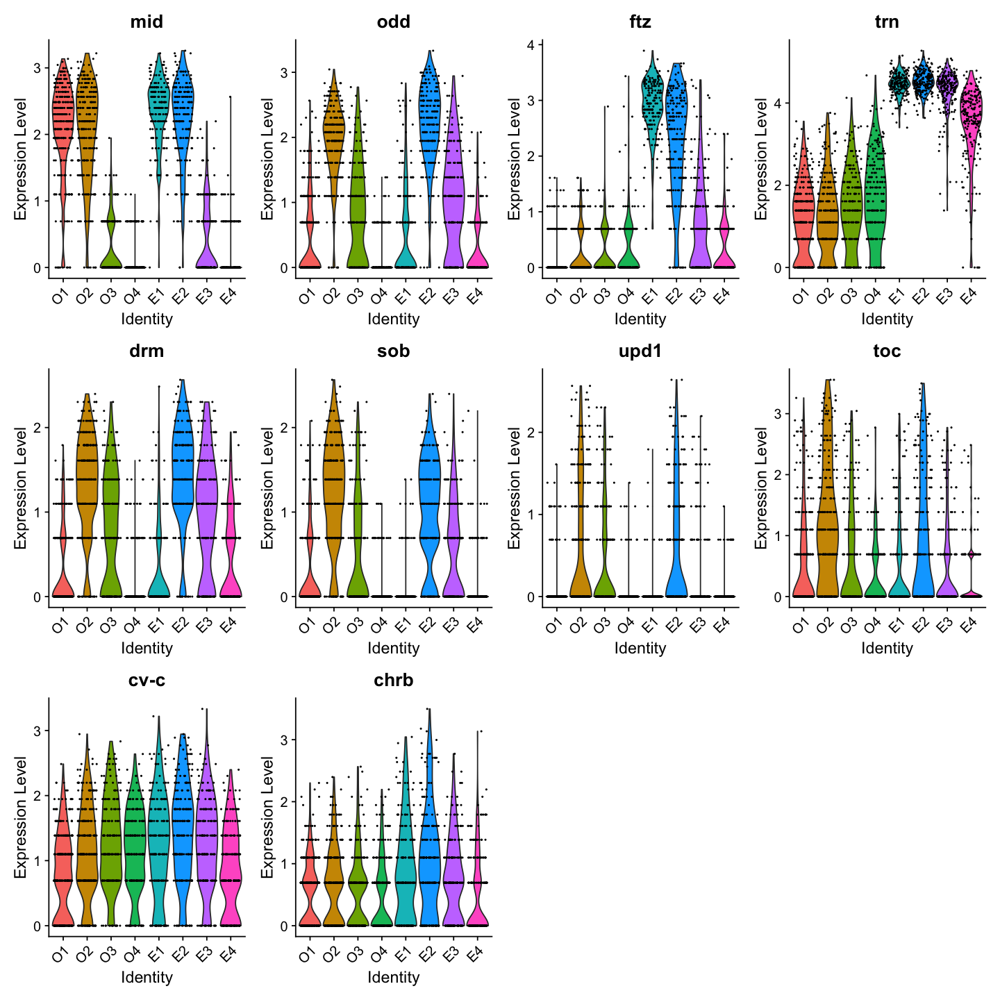

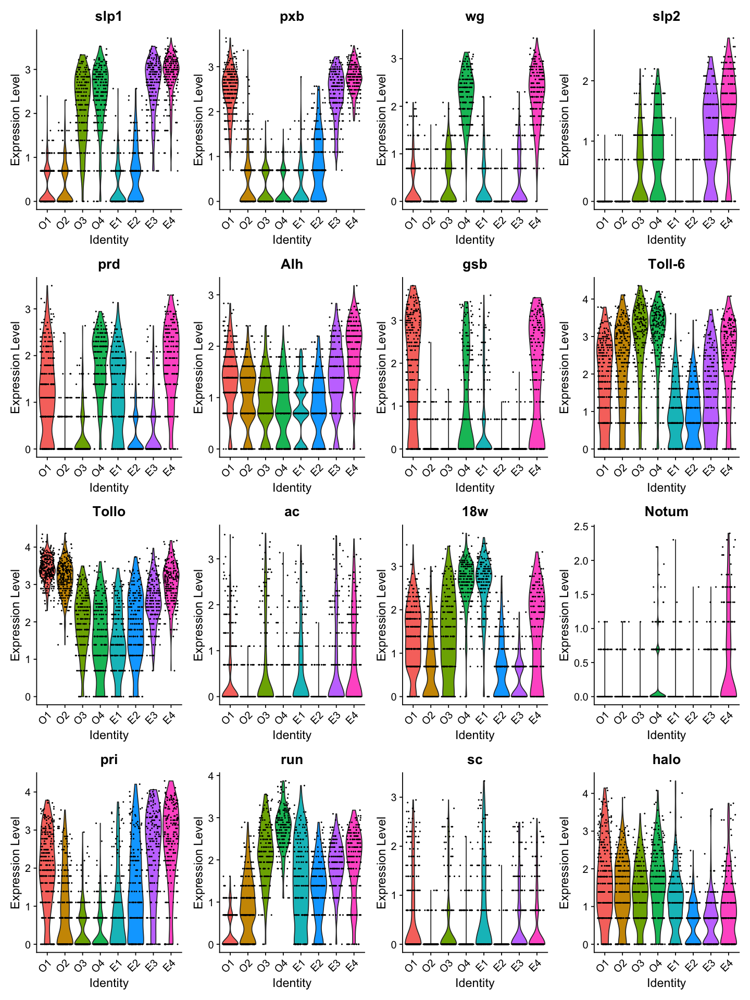

In [13]:
DE_E2vsE4 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E2",
  ident.2 = "E4",
  logfc.threshold = log(1.75),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E2vsE4_FWER0.01_FC1.75 <- filter(DE_E2vsE4, p_val_adj <= 0.01)

compaired_ID <- rep("E2vsE4", length=nrow(DE_E2vsE4_FWER0.01_FC1.75)) 
DE_E2vsE4_FWER0.01_FC1.75 <- cbind(DE_E2vsE4_FWER0.01_FC1.75, compaired_ID)
DE_E2vsE4_FWER0.01_FC1.75

DE_E2vsE4_FWER0.01_FC1.75_plus <- filter(DE_E2vsE4, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_E2vsE4_FWER0.01_FC1.75_plus
dim(DE_E2vsE4_FWER0.01_FC1.75_plus)
DE_E2vsE4_FWER0.01_FC1.75_minus <- filter(DE_E2vsE4, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_E2vsE4_FWER0.01_FC1.75_minus
dim(DE_E2vsE4_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E2vsE4_FWER0.01_FC1.75_plus)/4))
"DEGs E2vsE4, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E2vsE4_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E2vsE4_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E2vsE4_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E2vsE4_FWER0.01_FC1.75_minus)/4))
"DEGs E2vsE4, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E2vsE4_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E2vsE4_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E2vsE4_FWER0.01_FC1.75_minus)/4))

write.table(DE_E2vsE4_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_E2vsE4_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

### E3 vs. O1


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
trn,3.005336e-180,2.8265645,1.000,0.751,9.016007e-177,E3vsO1
slp1,6.488949e-136,2.3822797,1.000,0.330,1.946685e-132,E3vsO1
hh,4.532104e-133,-2.2525026,0.062,0.996,1.359631e-129,E3vsO1
eve,5.689318e-123,-2.5260607,0.351,0.989,1.706795e-119,E3vsO1
ich,2.771625e-118,-2.5564066,0.191,0.954,8.314876e-115,E3vsO1
en,9.990649e-105,-1.9979968,0.098,0.944,2.997195e-101,E3vsO1
run,1.999046e-104,1.6332040,0.985,0.302,5.997139e-101,E3vsO1
mid,1.202446e-94,-1.6962504,0.397,0.965,3.607337e-91,E3vsO1
comm,4.500820e-79,1.4546954,0.948,0.253,1.350246e-75,E3vsO1


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
trn,3.005336e-180,2.8265645,1.000,0.751,9.016007e-177
slp1,6.488949e-136,2.3822797,1.000,0.330,1.946685e-132
run,1.999046e-104,1.6332040,0.985,0.302,5.997139e-101
comm,4.500820e-79,1.4546954,0.948,0.253,1.350246e-75
slp2,1.209835e-70,1.2089843,0.763,0.035,3.629504e-67
comm2,1.755748e-61,1.1512057,0.768,0.084,5.267243e-58
CG10479,1.366765e-43,1.0888689,0.912,0.656,4.100295e-40
Ppa,2.810965e-40,0.6052541,1.000,0.993,8.432894e-37
CG15480,6.330846e-39,1.1201126,0.959,0.670,1.899254e-35


[1] 19  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
hh,4.532104e-133,-2.2525026,0.062,0.996,1.359631e-129
eve,5.689318e-123,-2.5260607,0.351,0.989,1.706795e-119
ich,2.771625e-118,-2.5564066,0.191,0.954,8.314876e-115
en,9.990649e-105,-1.9979968,0.098,0.944,2.997195e-101
mid,1.202446e-94,-1.6962504,0.397,0.965,3.607337e-91
rdx,4.683254e-69,-0.9300209,0.995,1.000,1.404976e-65
gsb,2.790732e-66,-2.2798155,0.113,0.814,8.372195e-63
Tollo,3.619562e-64,-0.7741319,1.000,1.000,1.085869e-60
18w,1.065737e-45,-1.1718360,0.418,0.898,3.197212e-42


[1] 19  5

[1] "DEGs E3vsO1, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs E3vsO1, avgFC <= -1.5, FWER <= 0.01"

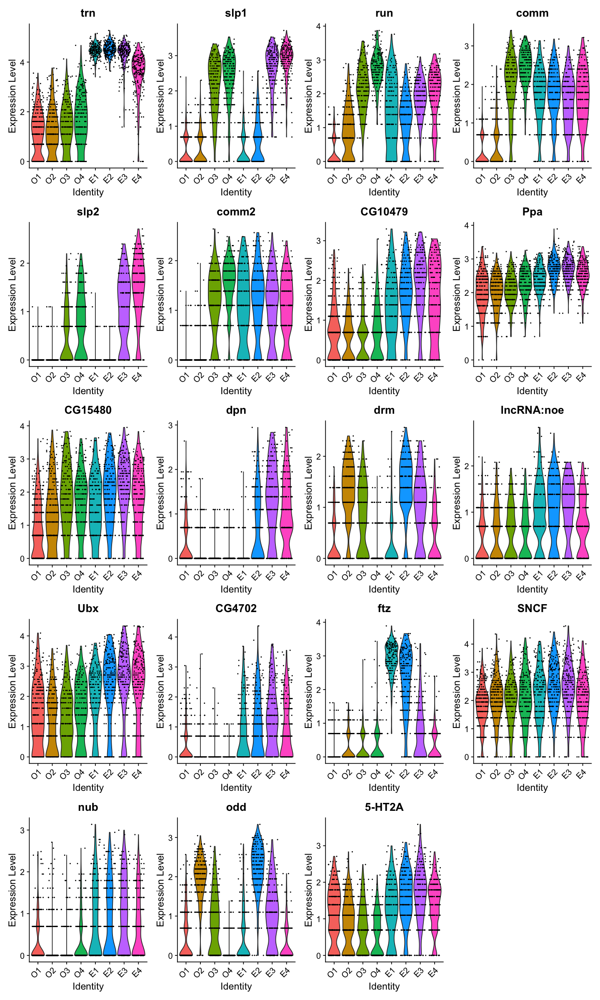

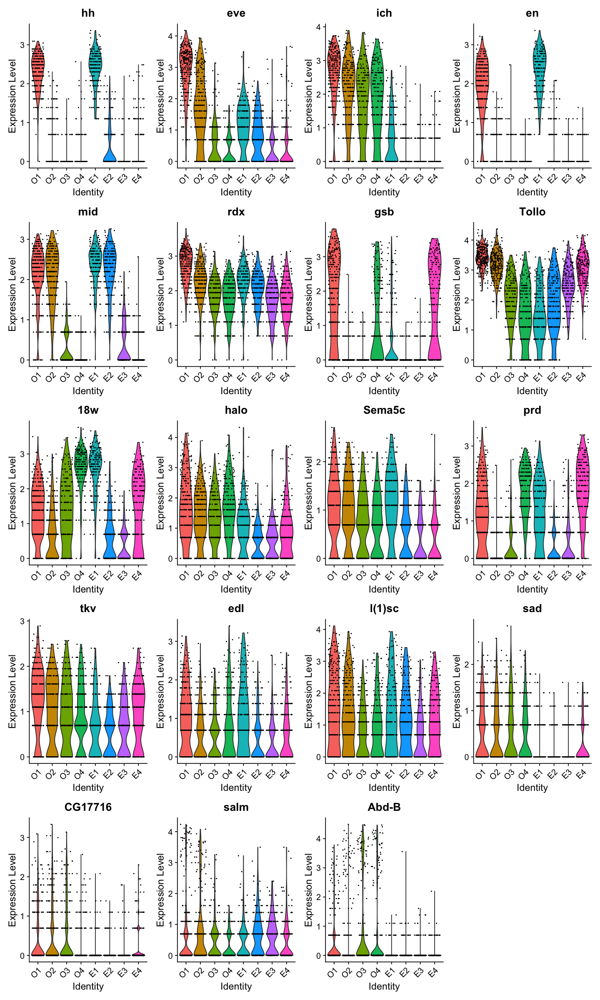

In [14]:
DE_E3vsO1 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E3",
  ident.2 = "O1",
  logfc.threshold = log(1.75),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E3vsO1_FWER0.01_FC1.75 <- filter(DE_E3vsO1, p_val_adj <= 0.01)

compaired_ID <- rep("E3vsO1", length=nrow(DE_E3vsO1_FWER0.01_FC1.75)) 
DE_E3vsO1_FWER0.01_FC1.75 <- cbind(DE_E3vsO1_FWER0.01_FC1.75, compaired_ID)
DE_E3vsO1_FWER0.01_FC1.75

DE_E3vsO1_FWER0.01_FC1.75_plus <- filter(DE_E3vsO1, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_E3vsO1_FWER0.01_FC1.75_plus
dim(DE_E3vsO1_FWER0.01_FC1.75_plus)
DE_E3vsO1_FWER0.01_FC1.75_minus <- filter(DE_E3vsO1, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_E3vsO1_FWER0.01_FC1.75_minus
dim(DE_E3vsO1_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E3vsO1_FWER0.01_FC1.75_plus)/4))
"DEGs E3vsO1, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E3vsO1_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E3vsO1_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E3vsO1_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E3vsO1_FWER0.01_FC1.75_minus)/4))
"DEGs E3vsO1, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E3vsO1_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E3vsO1_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E3vsO1_FWER0.01_FC1.75_minus)/4))

write.table(DE_E3vsO1_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_E3vsO1_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

### E4 vs. O2


 Completed [==================================>---------]  80% with 0 failures

 Completed [===================================>--------]  83% with 0 failures

 Completed [=====================================>------]  85% with 0 failures

 Completed [======================================>-----]  88% with 0 failures

 Completed [=======================================>----]  90% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


 Completed [=======================>--------------

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
slp1,1.677500e-160,2.4707665,1.000,0.375,5.032499e-157,E4vsO2
pxb,5.577120e-155,2.0898043,1.000,0.402,1.673136e-151,E4vsO2
wg,1.003707e-123,2.2479730,0.995,0.069,3.011120e-120,E4vsO2
mid,4.744881e-103,-1.9862480,0.201,0.973,1.423464e-99,E4vsO2
odd,6.267461e-100,-1.6249148,0.304,0.973,1.880238e-96,E4vsO2
trn,2.530716e-96,2.0146648,0.975,0.808,7.592149e-93,E4vsO2
slp2,8.718254e-91,1.5787282,0.882,0.046,2.615476e-87,E4vsO2
prd,1.088537e-82,1.7872433,0.941,0.226,3.265610e-79,E4vsO2
ich,4.914962e-79,-2.0753224,0.230,0.931,1.474489e-75,E4vsO2


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,1.677500e-160,2.4707665,1.000,0.375,5.032499e-157
pxb,5.577120e-155,2.0898043,1.000,0.402,1.673136e-151
wg,1.003707e-123,2.2479730,0.995,0.069,3.011120e-120
trn,2.530716e-96,2.0146648,0.975,0.808,7.592149e-93
slp2,8.718254e-91,1.5787282,0.882,0.046,2.615476e-87
prd,1.088537e-82,1.7872433,0.941,0.226,3.265610e-79
comm,2.657650e-57,1.2865409,0.951,0.406,7.972950e-54
gsb,3.926975e-53,2.0596211,0.691,0.123,1.178093e-49
comm2,7.009582e-50,0.9963641,0.794,0.157,2.102874e-46


[1] 23  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
mid,4.744881e-103,-1.9862480,0.201,0.973,1.423464e-99
odd,6.267461e-100,-1.6249148,0.304,0.973,1.880238e-96
ich,4.914962e-79,-2.0753224,0.230,0.931,1.474489e-75
sob,6.915959e-64,-1.1531643,0.196,0.889,2.074788e-60
drm,4.625966e-44,-0.8753035,0.456,0.916,1.387790e-40
ImpL2,1.575469e-43,-1.0728297,0.966,0.996,4.726406e-40
eve,2.674901e-36,-1.2591861,0.328,0.835,8.024702e-33
Pino,2.371185e-31,-0.6443070,0.971,1.000,7.113556e-28
toc,7.182140e-30,-1.3215539,0.250,0.724,2.154642e-26


[1] 17  5

[1] "DEGs E4vsO2, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs E4vsO2, avgFC <= -1.5, FWER <= 0.01"

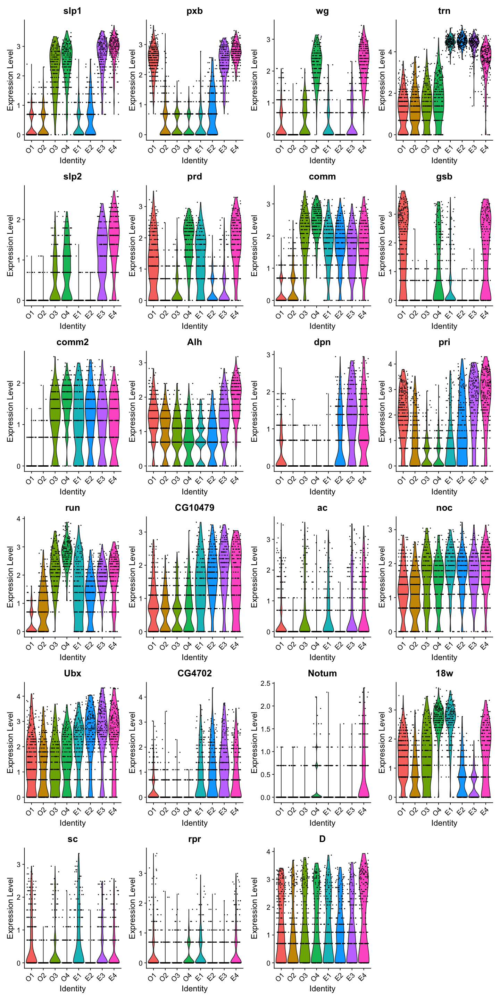

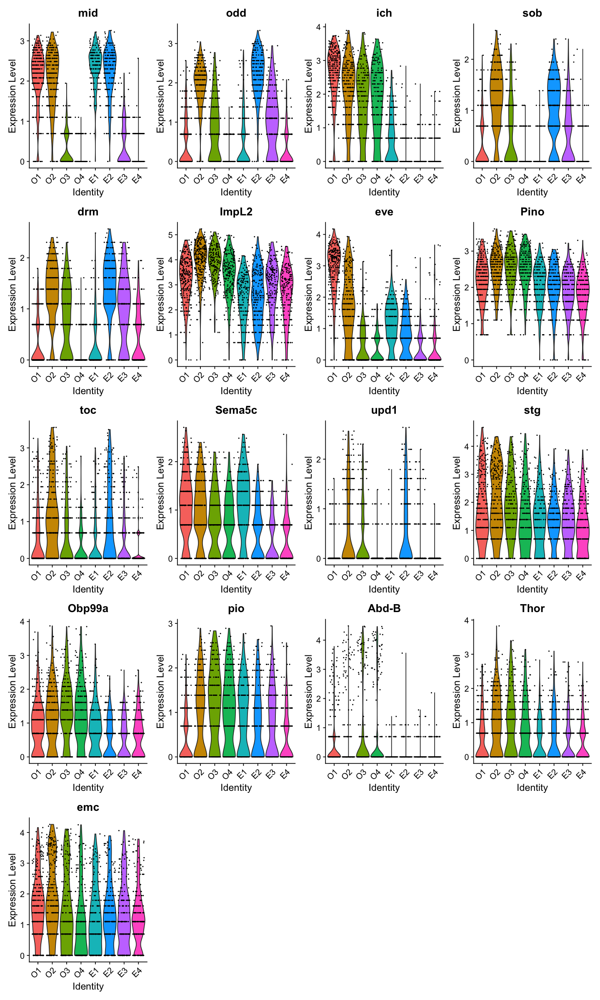

In [15]:
DE_E4vsO2 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E4",
  ident.2 = "O2",
  logfc.threshold = log(1.75),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E4vsO2_FWER0.01_FC1.75 <- filter(DE_E4vsO2, p_val_adj <= 0.01)

compaired_ID <- rep("E4vsO2", length=nrow(DE_E4vsO2_FWER0.01_FC1.75)) 
DE_E4vsO2_FWER0.01_FC1.75 <- cbind(DE_E4vsO2_FWER0.01_FC1.75, compaired_ID)
DE_E4vsO2_FWER0.01_FC1.75

DE_E4vsO2_FWER0.01_FC1.75_plus <- filter(DE_E4vsO2, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_E4vsO2_FWER0.01_FC1.75_plus
dim(DE_E4vsO2_FWER0.01_FC1.75_plus)
DE_E4vsO2_FWER0.01_FC1.75_minus <- filter(DE_E4vsO2, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_E4vsO2_FWER0.01_FC1.75_minus
dim(DE_E4vsO2_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E4vsO2_FWER0.01_FC1.75_plus)/4))
"DEGs E4vsO2, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E4vsO2_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E4vsO2_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E4vsO2_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E4vsO2_FWER0.01_FC1.75_minus)/4))
"DEGs E4vsO2, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E4vsO2_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E4vsO2_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E4vsO2_FWER0.01_FC1.75_minus)/4))

write.table(DE_E4vsO2_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_E4vsO2_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

## Merge results

In [16]:
DE_O1vsO3_FWER0.01_FC1.75 <- DE_O1vsO3_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_O2vsO4_FWER0.01_FC1.75 <- DE_O2vsO4_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_O3vsE1_FWER0.01_FC1.75 <- DE_O3vsE1_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_O4vsE2_FWER0.01_FC1.75 <- DE_O4vsE2_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_E1vsE3_FWER0.01_FC1.75 <- DE_E1vsE3_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_E2vsE4_FWER0.01_FC1.75 <- DE_E2vsE4_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_E3vsO1_FWER0.01_FC1.75 <- DE_E3vsO1_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_E4vsO2_FWER0.01_FC1.75 <- DE_E4vsO2_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_all_FWER0.01_FC1.75 <- rbind(DE_O1vsO3_FWER0.01_FC1.75, DE_O2vsO4_FWER0.01_FC1.75, DE_O3vsE1_FWER0.01_FC1.75, 
                              DE_O4vsE2_FWER0.01_FC1.75, DE_E1vsE3_FWER0.01_FC1.75, DE_E2vsE4_FWER0.01_FC1.75,
                             DE_E3vsO1_FWER0.01_FC1.75, DE_E4vsO2_FWER0.01_FC1.75)

In [17]:
DE_all_FWER0.01_FC1.75

gene_name,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
pxb,1.990864e-144,2.1899253,1.000,0.354,5.972592e-141,O1vsO3
hh,5.196754e-139,2.3203573,0.996,0.053,1.559026e-135,O1vsO3
eve,2.079641e-109,2.2680469,0.989,0.455,6.238923e-106,O1vsO3
mid,1.584758e-107,1.8990632,0.965,0.328,4.754274e-104,O1vsO3
run,2.032456e-105,-1.9959873,0.302,0.989,6.097368e-102,O1vsO3
en,1.538282e-100,1.9535365,0.944,0.095,4.614845e-97,O1vsO3
Tollo,4.127857e-99,1.1862407,1.000,0.963,1.238357e-95,O1vsO3
slp1,4.857894e-98,-1.9855340,0.330,0.979,1.457368e-94,O1vsO3
comm,2.632365e-90,-1.8895844,0.253,0.937,7.897094e-87,O1vsO3


In [18]:
table(DE_all_FWER0.01_FC1.75$compaired_ID)


E1vsE3 E2vsE4 E3vsO1 E4vsO2 O1vsO3 O2vsO4 O3vsE1 O4vsE2 
    31     26     38     40     30     25     31     42 

In [19]:
length(unique(DE_all_FWER0.01_FC1.75$gene_name))

[1] 84

In [20]:
write.table(DE_all_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_all_FWER0.01_FC1.75_superboundary.txt", 
            sep="\t", col.names=T, row.names=F, quote=F)

In [21]:
write(unique(DE_all_FWER0.01_FC1.75$gene_name), file = "./DEG_superboundary_FC1.75/unique_DEGs_list_FWER0.01_FC1.75_superboundary.txt" )

[1] "DEGs all unique, avgFC <= -1.5, FWER <= 0.01"

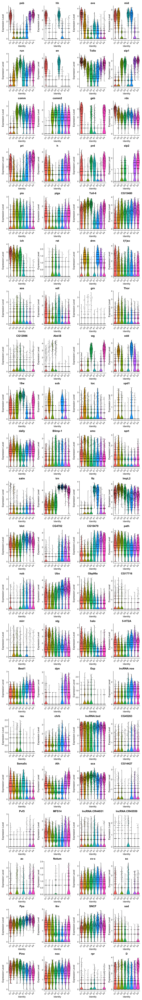

In [22]:
options(repr.plot.width=12, repr.plot.height=4*ceiling(length(unique(DE_all_FWER0.01_FC1.75$gene_name))/4))
"DEGs all unique, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = unique(DE_all_FWER0.01_FC1.75$gene_name), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_unique_all_FC1.75_superboundary.png", 
       width = 10.24, height = 2.56*ceiling(length(unique(DE_all_FWER0.01_FC1.75$gene_name))/4), limitsize = FALSE)

In [23]:
unique(DE_all_FWER0.01_FC1.75$gene_name)

[1] "pxb"            "hh"             "eve"            "mid"           
 [5] "run"            "en"             "Tollo"          "slp1"          
 [9] "comm"           "comm2"          "gsb"            "rdx"           
[13] "pri"            "h"              "prd"            "slp2"          
[17] "pio"            "pigs"           "Toll-6"         "CG15480"       
[21] "ich"            "rst"            "drm"            "l(1)sc"        
[25] "aos"            "edl"            "grn"            "Thor"          
[29] "CG12986"        "Abd-B"          "wg"             "odd"           
[33] "18w"            "sob"            "toc"            "upd1"          
[37] "dally"          "Blimp-1"        "emc"            "sprt"          
[41] "salm"           "trn"            "ftz"            "ImpL2"         
[45] "blot"           "CG4702"         "CG10479"        "path"          
[49] "nub"            "Ubx"            "Obp99a"         "CG17716"       
[53] "mirr"           "stg"            "halo"           "5-HT2A"        
[57] "Best1"          "dpn"            "Esp"            "lncRNA:noe"    
[61] "rau"            "chrb"           "lncRNA:bxd"     "CG45263"       
[65] "Sema5c"         "Alh"            "sca"            "CG14427"       
[69] "Pvf3"           "MFS14"          "lncRNA:CR44931" "lncRNA:CR45559"
[73] "ac"             "Notum"          "cv-c"           "sc"            
[77] "Ppa"            "tkv"            "SNCF"           "sad"           
[81] "Pino"           "noc"            "rpr"            "D"

In [24]:
options(repr.plot.width=3, repr.plot.height=4)
for (i in unique(DE_all_FWER0.01_FC1.75$gene_name)){
plot <- VlnPlot(seu_PR_VF3000, features = paste(i), pt.size = 0.2, ncol = 1)  + 
scale_fill_manual(values = c("skyblue1", "skyblue2", "skyblue3", "skyblue4", "magenta1", "magenta2", "magenta3", "magenta4")) +
NoLegend()
ggsave(filename=paste("./DEG_superboundary_FC1.75/unique_plot/DEGs_unique_all_FC1.75_",i,".png", sep=""), 
       width = 3.84, height = 5.12, limitsize = FALSE)
}



In [25]:
sessionInfo()

R version 4.0.3 (2020-10-10)
Platform: x86_64-apple-darwin17.0 (64-bit)
Running under: macOS Catalina 10.15.7

Matrix products: default
BLAS:   /Library/Frameworks/R.framework/Versions/4.0/Resources/lib/libRblas.dylib
LAPACK: /Library/Frameworks/R.framework/Versions/4.0/Resources/lib/libRlapack.dylib

locale:
[1] ja_JP.UTF-8/ja_JP.UTF-8/ja_JP.UTF-8/C/ja_JP.UTF-8/ja_JP.UTF-8

attached base packages:
[1] parallel  stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] MAST_1.16.0                 SingleCellExperiment_1.12.0
 [3] SummarizedExperiment_1.20.0 Biobase_2.50.0             
 [5] GenomicRanges_1.42.0        GenomeInfoDb_1.26.2        
 [7] IRanges_2.24.1              S4Vectors_0.28.1           
 [9] BiocGenerics_0.36.0         MatrixGenerics_1.2.0       
[11] matrixStats_0.57.0          tibble_3.0.5               
[13] dplyr_1.0.3                 Matrix_1.3-2               
[15] data.table_1.13.6           magrittr_2.0.1